In [19]:
import numpy as np
import matplotlib.pyplot as plt
import os
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential , Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.preprocessing.image import load_img , array_to_img

In [20]:
base_dir = "archive/data/"

In [21]:
image_paths = []
for image in os.listdir(base_dir) :
    image_path = os.path.join(base_dir,image)
    image_paths.append(image_path)

In [22]:
print(image_paths[:5])
print(len(image_paths))

['archive/data/1.png', 'archive/data/10.png', 'archive/data/100.png', 'archive/data/1000.png', 'archive/data/10000.png']
21551


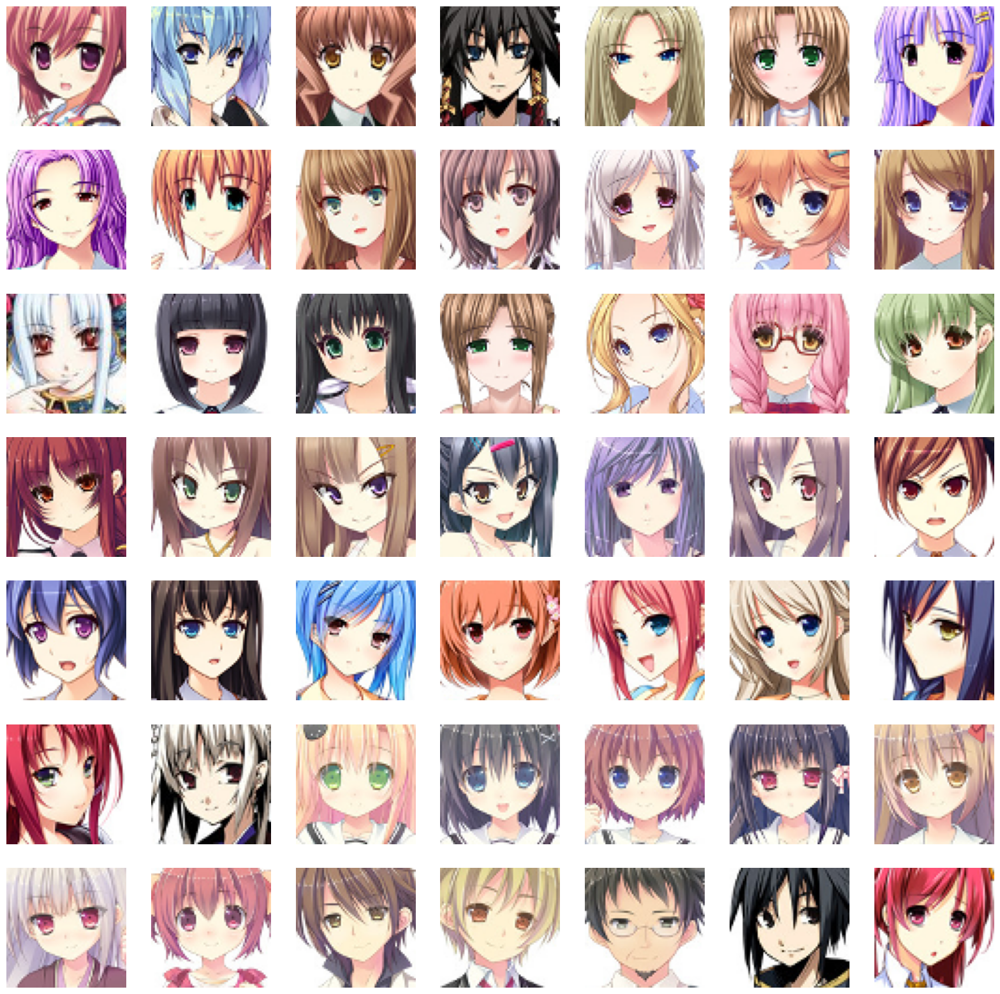

In [23]:
plt.figure(figsize = (20,20))
temp_images = image_paths [:49]

i = 1
for image in temp_images :
    plt.subplot(7,7,i)
    img = load_img(image)
    img = np.array(img)
    plt.imshow(img)
    plt.axis("off")
    i+=1

In [24]:
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [25]:
print(train_images.shape)

(21551, 64, 64, 3)


In [26]:
train_images = train_images.reshape(train_images.shape[0] , 64 , 64 , 3).astype('float32')

In [27]:
train_images = (train_images - 127.5)/127.5

In [28]:
train_images[0]

array([[[ 0.94509804,  0.42745098,  0.24705882],
        [ 0.96862745,  0.44313726,  0.33333334],
        [ 0.9529412 ,  0.5058824 ,  0.35686275],
        ...,
        [ 0.38039216, -0.38039216, -0.19215687],
        [ 0.43529412, -0.34117648, -0.15294118],
        [ 0.49019608, -0.1764706 , -0.02745098]],

       [[ 0.90588236,  0.43529412,  0.23137255],
        [ 0.92941177,  0.43529412,  0.3254902 ],
        [ 0.9529412 ,  0.44313726,  0.35686275],
        ...,
        [ 0.33333334, -0.3647059 , -0.19215687],
        [ 0.39607844, -0.37254903, -0.16862746],
        [ 0.35686275, -0.3647059 , -0.19215687]],

       [[ 0.8980392 ,  0.4117647 ,  0.2627451 ],
        [ 0.96862745,  0.4745098 ,  0.33333334],
        [ 0.75686276,  0.14509805,  0.16078432],
        ...,
        [ 0.40392157, -0.31764707, -0.12156863],
        [ 0.38039216, -0.37254903, -0.16078432],
        [ 0.35686275, -0.40392157, -0.20784314]],

       ...,

       [[ 1.        ,  1.        ,  1.        ],
        [ 1

## create generator and descriminator models

In [29]:
latent_dim = 100
num_channels = 3
weight_init = keras.initializers.RandomNormal(mean = 0.0 , stddev = 0.02)

### generator

In [30]:
model = keras.Sequential(name = "generator")

model.add(layers.Dense((8*8*512) , input_shape = (latent_dim,)))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Reshape((8,8,512)))

model.add(layers.Conv2DTranspose(256 , (4,4) , strides = (2,2) , padding = "same" , kernel_initializer = weight_init ))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2DTranspose(128 , (4,4) , strides = (2,2) , padding = "same" , kernel_initializer = weight_init ))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2DTranspose(64 , (4,4) , strides = (2,2) , padding = "same" , kernel_initializer = weight_init ))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(num_channels , (4,4) , padding = "same" , activation = "tanh"))


In [31]:
generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_2 (Dense)                 │ (None, 32768)          │     3,309,568 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_4 (ReLU)                  │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape_1 (Reshape)             │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_3              │ (None, 16, 16, 256)    │     2,097,408 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_5 (ReLU)                  │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_4              │ (None, 32, 32, 128)    │       524,416 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_6 (ReLU)                  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_5              │ (None, 64, 64, 64)     │       131,136 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_7 (ReLU)                  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 64, 64, 3)      │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

### descriminator

In [32]:
model = keras.Sequential(name = "descriminator")
input_shape = (64,64,3)
alpha = 0.2

model.add(layers.Conv2D(64 , (4,4) , strides = (2,2) , padding = "same" , input_shape = input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(negative_slope = alpha))

model.add(layers.Conv2D(128 , (4,4) , strides = (2,2) , padding = "same" ))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(negative_slope = alpha))

model.add(layers.Conv2D(128 , (4,4) , strides = (2,2) , padding = "same" ))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(negative_slope = alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))
model.add(layers.Dense(1 , activation="sigmoid"))


In [33]:
descriminator = model
descriminator.summary()

Model: "descriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_5 (Conv2D)               │ (None, 32, 32, 64)     │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 16, 16, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 8, 8, 128)      │       262,272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 8, 8, 128)      │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

## create DCGAN

In [34]:
class DCGAN (keras.Model):
    def __init__ (self , generator , descriminator , latent_dim):
        super().__init__()
        self.generator = generator
        self.descriminator = descriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name = "g_loss")
        self.d_loss_metric = keras.metrics.Mean(name = "d_loss") 

    @property
    def metrics (self):
        return[self.g_loss_metric , self.d_loss_metric]

    def compile (self , g_optimizer , d_optimizer , loss_func):
        super(DCGAN , self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_func = loss_func

    def train_step (self , real_images):
        batch_size = tf.shape(real_images)[0]
        random_noise = tf.random.normal(shape = (batch_size , self.latent_dim))

        ################ step to train the discriminator
        with tf.GradientTape() as tape:
            # training the discriminator on real images
            real_labels = tf.ones((batch_size , 1))
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels)) 

            pred_real = self.descriminator(real_images , training=True)
            d_loss_real = self.loss_func(real_labels , pred_real)

            # training the discriminator on fake images
            fake_images = self.generator(random_noise)

            fake_labels = tf.zeros((batch_size , 1))
            pred_fake = self.descriminator(fake_images , training=True)

            d_loss_fake = self.loss_func(fake_labels , pred_fake)

            d_loss = (d_loss_real + d_loss_fake) / 2

        gradients = tape.gradient(d_loss , self.descriminator.trainable_variables)
        # update the variables
        self.d_optimizer.apply_gradients(zip(gradients ,  self.descriminator.trainable_variables))

        ################ step to train the generator

        decieving_labels = tf.ones((batch_size , 1))

        with tf.GradientTape() as tape:
            fake_images = self.generator(random_noise , training=True)
            pred_fake = self.descriminator(fake_images, training=True)

            g_loss = self.loss_func(decieving_labels , pred_fake)

        gradients = tape.gradient(g_loss , self.generator.trainable_variables)
        # update the variables
        self.g_optimizer.apply_gradients(zip(gradients , self.generator.trainable_variables)) 


        ##### update the loss metrics
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss) 

        return {"d_loss": self.d_loss_metric.result() , "g_loss" : self.g_loss_metric.result()}



## see the result of the generator over training

In [35]:
class DCGAN_monitor(keras.callbacks.Callback):
    def __init__ (self ,  latent_dim = 100):
        self.latent_dim = latent_dim
        self.random_noise = tf.random.normal(shape = (25,latent_dim))

    def on_epoch_end (self , epoch , logs = None):
        fake_images = self.model.generator(self.random_noise)
        fake_images = (fake_images*127.5) + 127.5
        fake_images.numpy()

        fig = plt.figure (figsize=(8,8))
        for i  in range (25):
            plt.subplot(5,5,i+1)
            image = array_to_img(fake_images[i])
            plt.imshow(image)
            plt.axis("off")

        plt.show()

    def on_train_end (self , logs = None):
        self.model.generator.save("generator.h5")   

## train the model :)

Epoch 1/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 828ms/step - d_loss: 1.2199 - g_loss: 1.8997

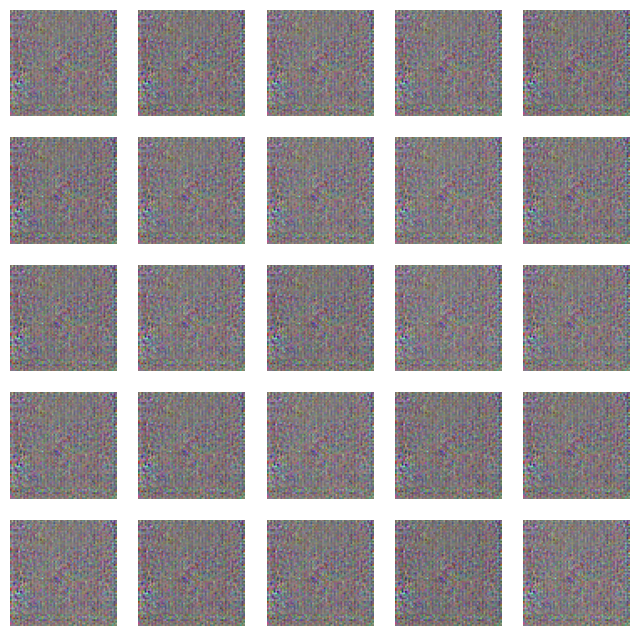

674/674 ━━━━━━━━━━━━━━━━━━━━ 567s 830ms/step - d_loss: 1.2189 - g_loss: 1.9011
Epoch 2/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 865ms/step - d_loss: 0.3493 - g_loss: 2.7480

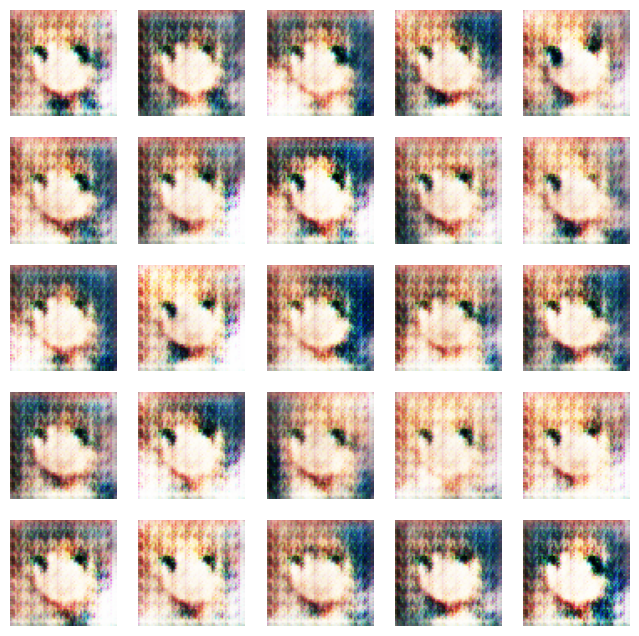

674/674 ━━━━━━━━━━━━━━━━━━━━ 584s 866ms/step - d_loss: 0.3495 - g_loss: 2.7470
Epoch 3/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - d_loss: 0.5829 - g_loss: 1.7575

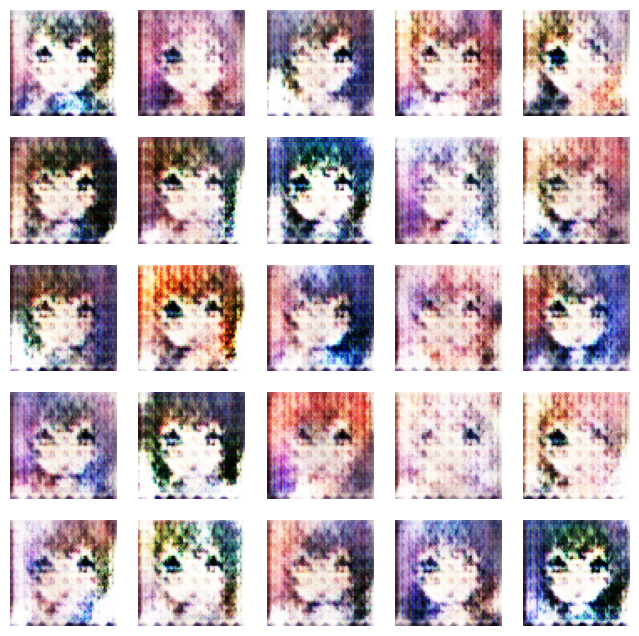

674/674 ━━━━━━━━━━━━━━━━━━━━ 4174s 6s/step - d_loss: 0.5829 - g_loss: 1.7575
Epoch 4/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 940ms/step - d_loss: 0.6137 - g_loss: 1.6509

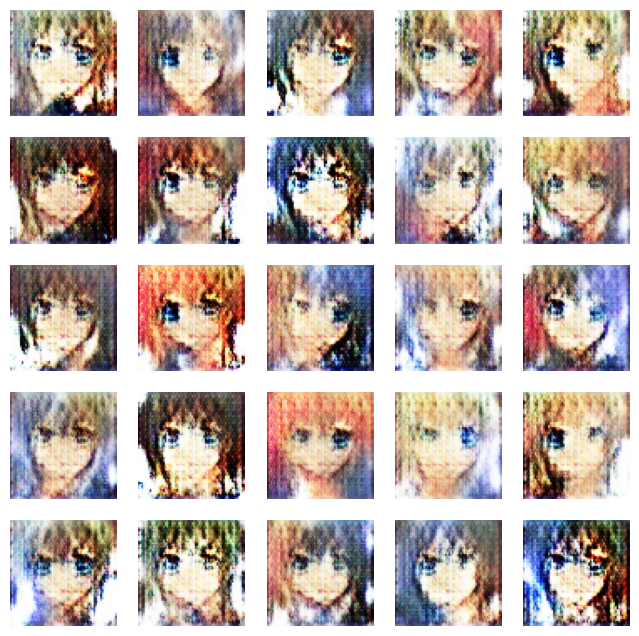

674/674 ━━━━━━━━━━━━━━━━━━━━ 635s 943ms/step - d_loss: 0.6136 - g_loss: 1.6510
Epoch 5/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 971ms/step - d_loss: 0.6243 - g_loss: 1.5699

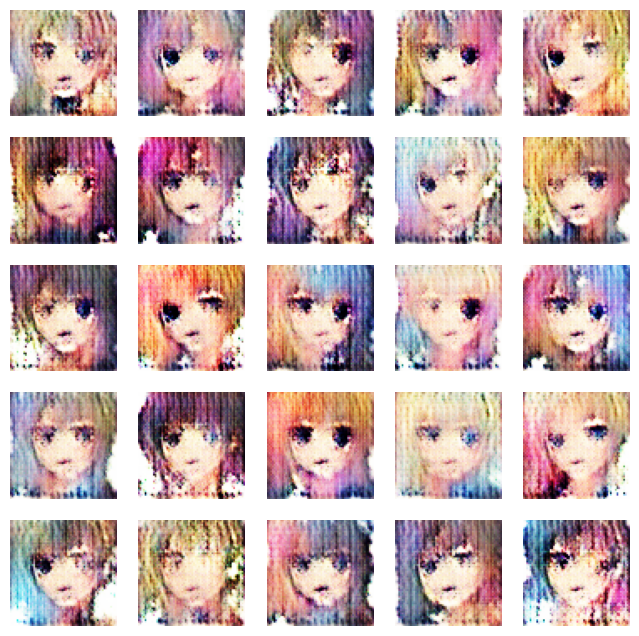

674/674 ━━━━━━━━━━━━━━━━━━━━ 657s 974ms/step - d_loss: 0.6243 - g_loss: 1.5699
Epoch 6/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 990ms/step - d_loss: 0.6199 - g_loss: 1.5749

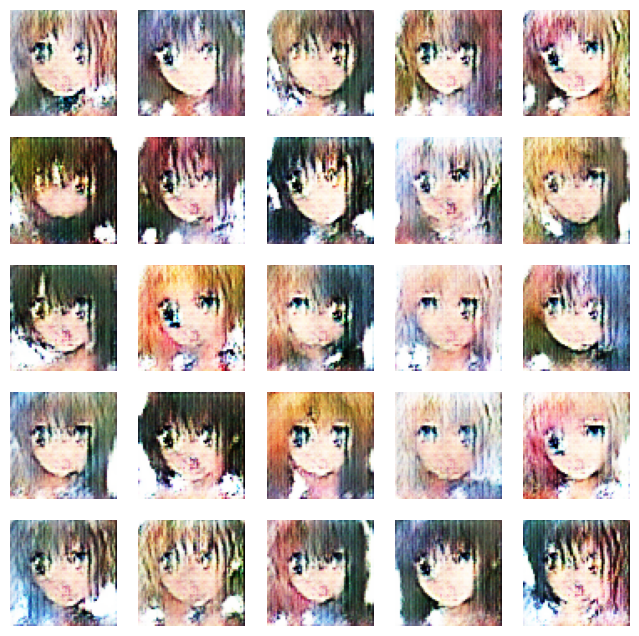

674/674 ━━━━━━━━━━━━━━━━━━━━ 669s 993ms/step - d_loss: 0.6199 - g_loss: 1.5748
Epoch 7/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 872ms/step - d_loss: 0.6235 - g_loss: 1.4592

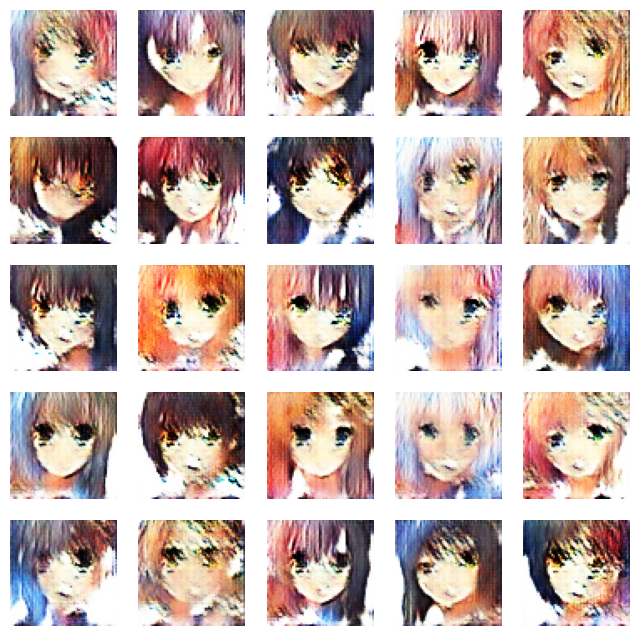

674/674 ━━━━━━━━━━━━━━━━━━━━ 589s 874ms/step - d_loss: 0.6235 - g_loss: 1.4591
Epoch 8/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 825ms/step - d_loss: 0.6277 - g_loss: 1.3101

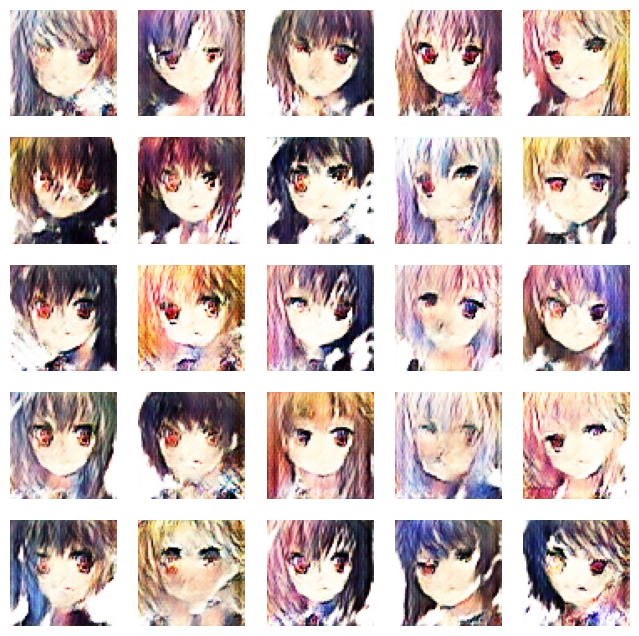

674/674 ━━━━━━━━━━━━━━━━━━━━ 558s 827ms/step - d_loss: 0.6277 - g_loss: 1.3101
Epoch 9/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 824ms/step - d_loss: 0.6313 - g_loss: 1.2718

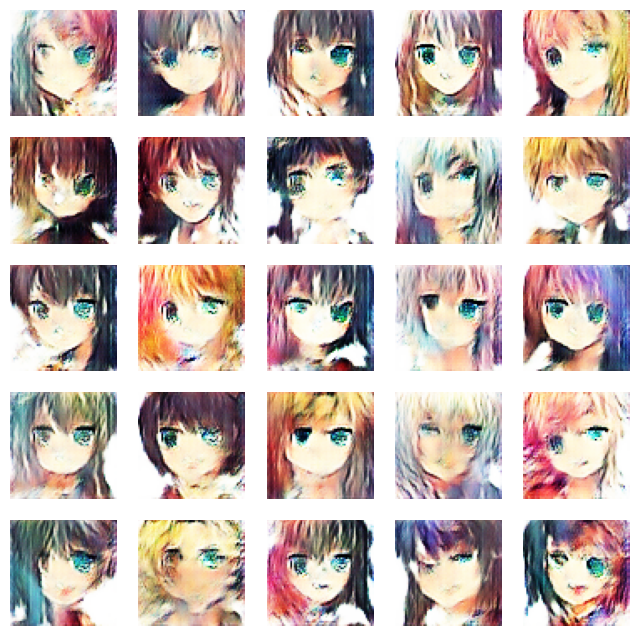

674/674 ━━━━━━━━━━━━━━━━━━━━ 557s 827ms/step - d_loss: 0.6313 - g_loss: 1.2717
Epoch 10/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6923 - g_loss: 1.0468

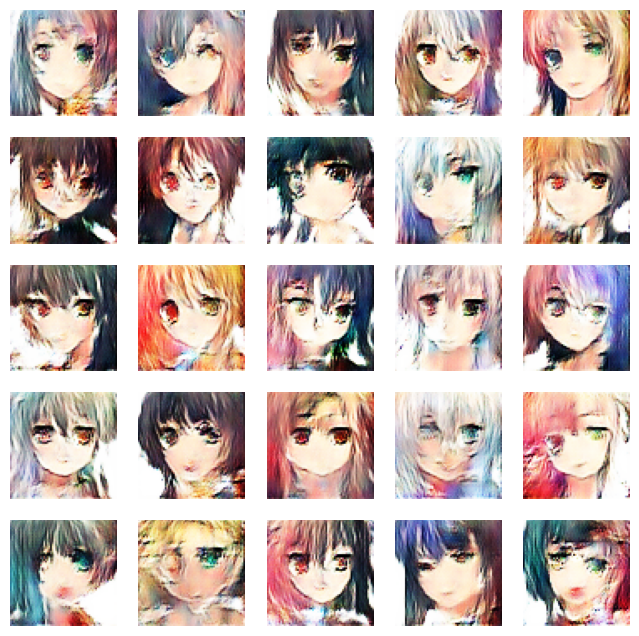

674/674 ━━━━━━━━━━━━━━━━━━━━ 765s 1s/step - d_loss: 0.6923 - g_loss: 1.0468
Epoch 11/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - d_loss: 0.7071 - g_loss: 0.9439

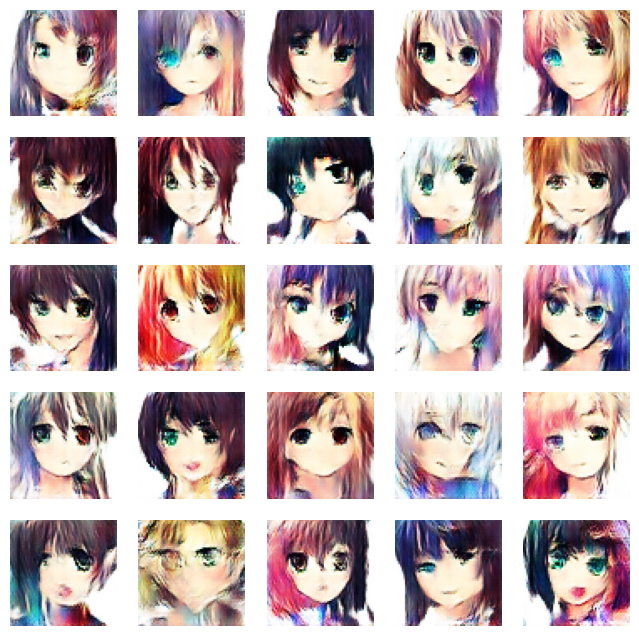

674/674 ━━━━━━━━━━━━━━━━━━━━ 2320s 3s/step - d_loss: 0.7070 - g_loss: 0.9439
Epoch 12/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 934ms/step - d_loss: 0.6975 - g_loss: 0.9216

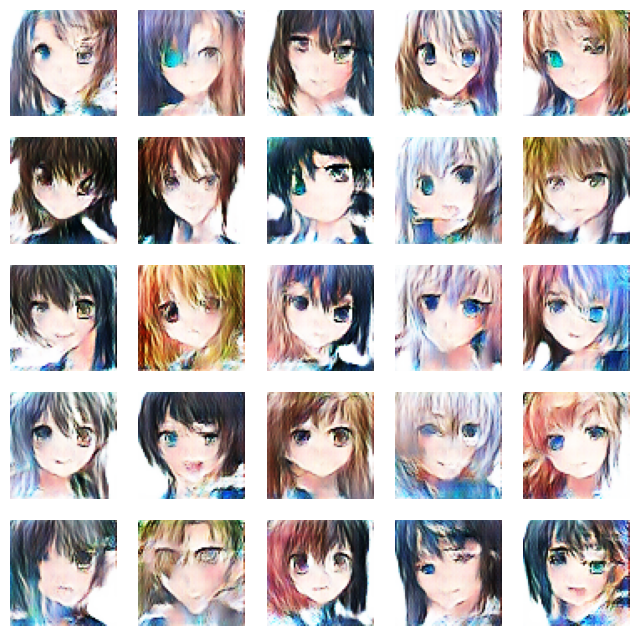

674/674 ━━━━━━━━━━━━━━━━━━━━ 631s 937ms/step - d_loss: 0.6975 - g_loss: 0.9216
Epoch 13/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 911ms/step - d_loss: 0.7033 - g_loss: 0.9103

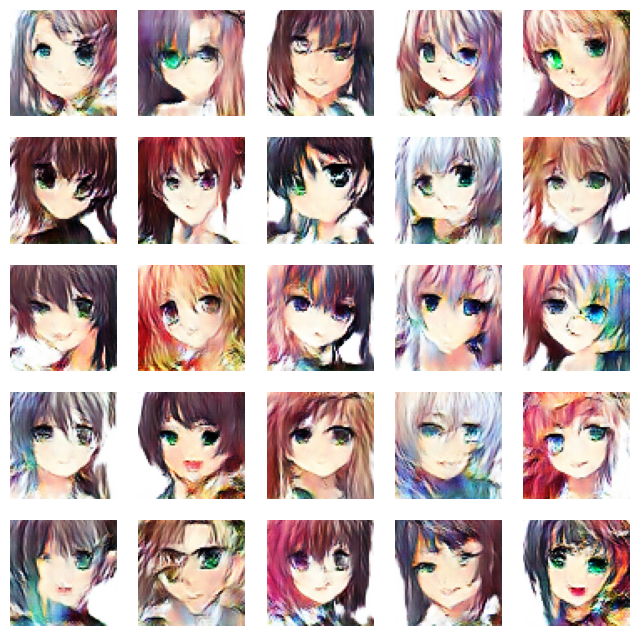

674/674 ━━━━━━━━━━━━━━━━━━━━ 616s 914ms/step - d_loss: 0.7033 - g_loss: 0.9103
Epoch 14/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6996 - g_loss: 0.8714

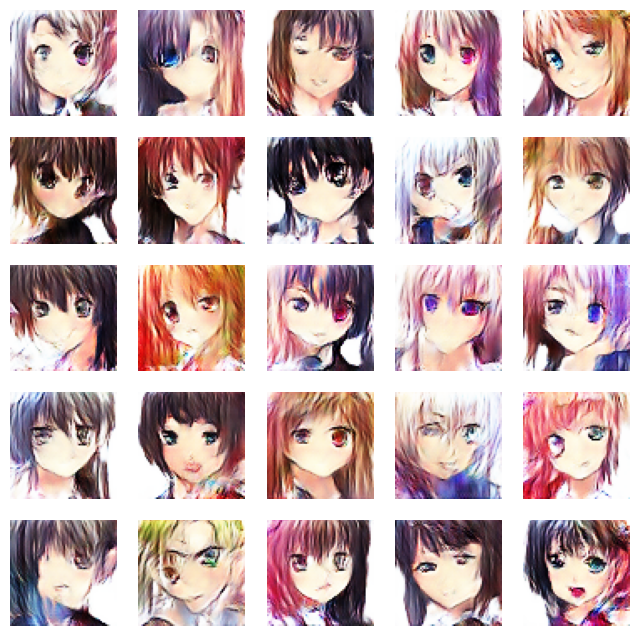

674/674 ━━━━━━━━━━━━━━━━━━━━ 886s 1s/step - d_loss: 0.6996 - g_loss: 0.8714
Epoch 15/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 46s/step - d_loss: 0.6969 - g_loss: 0.8573 

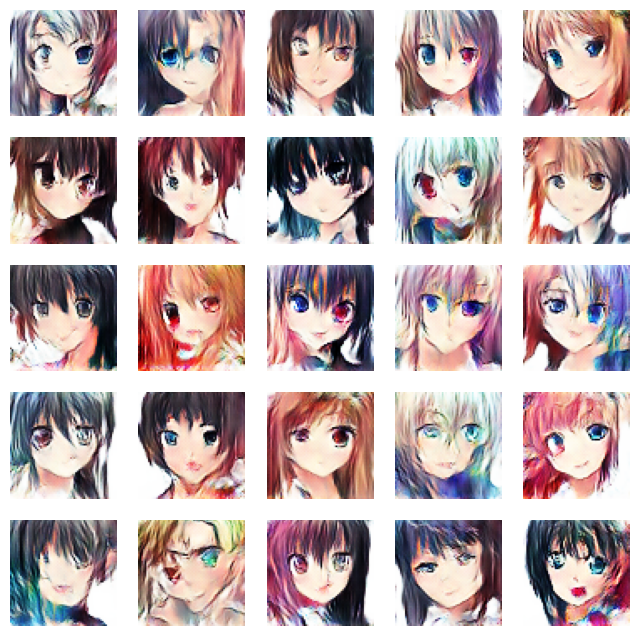

674/674 ━━━━━━━━━━━━━━━━━━━━ 30708s 46s/step - d_loss: 0.6969 - g_loss: 0.8573
Epoch 16/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 749ms/step - d_loss: 0.7012 - g_loss: 0.8436

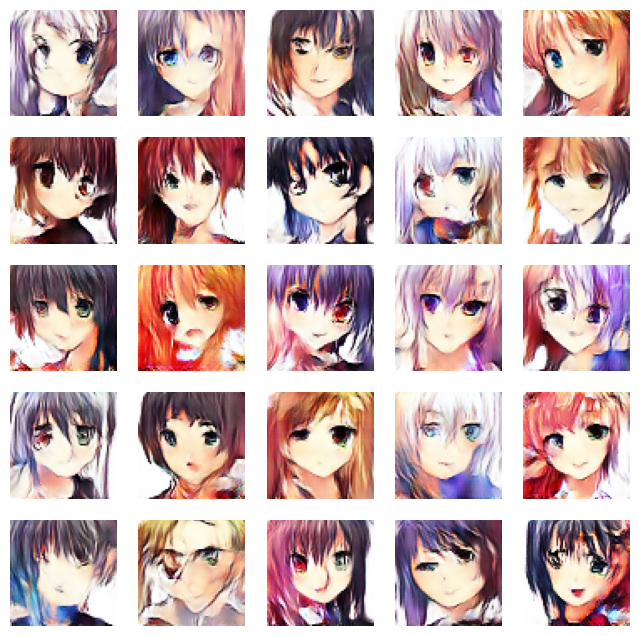

674/674 ━━━━━━━━━━━━━━━━━━━━ 507s 752ms/step - d_loss: 0.7012 - g_loss: 0.8436
Epoch 17/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 14s/step - d_loss: 0.7003 - g_loss: 0.8173 

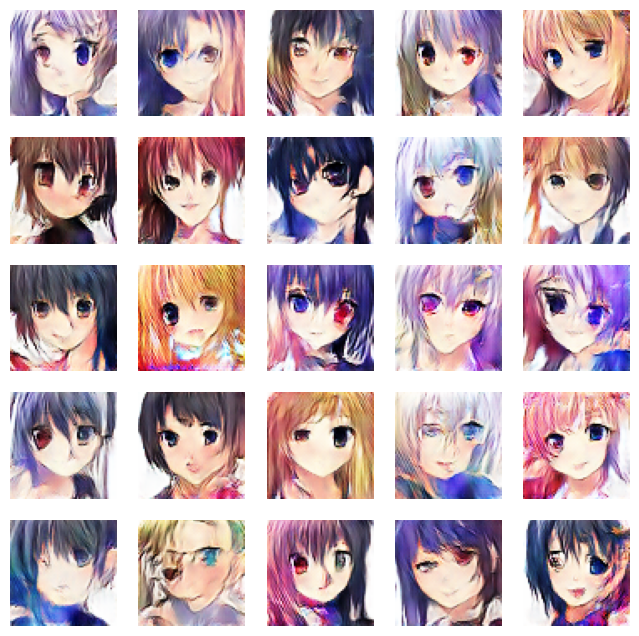

674/674 ━━━━━━━━━━━━━━━━━━━━ 9729s 14s/step - d_loss: 0.7003 - g_loss: 0.8173
Epoch 18/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7025 - g_loss: 0.7931

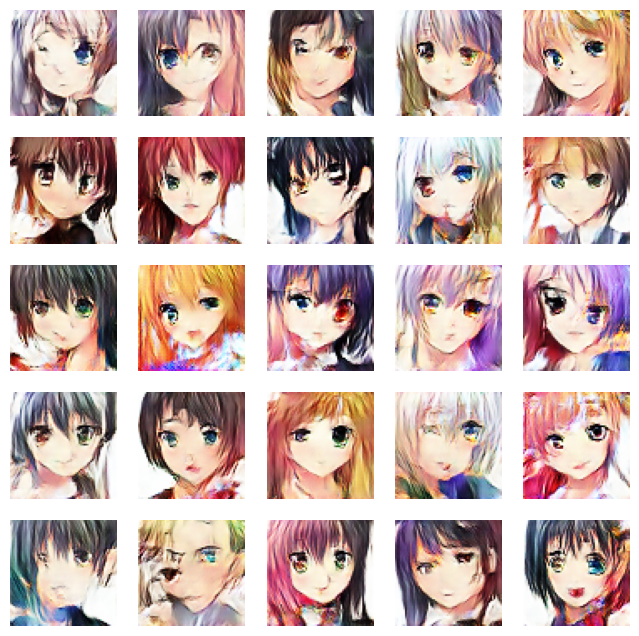

674/674 ━━━━━━━━━━━━━━━━━━━━ 3550s 5s/step - d_loss: 0.7025 - g_loss: 0.7931
Epoch 19/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - d_loss: 0.6966 - g_loss: 0.7890

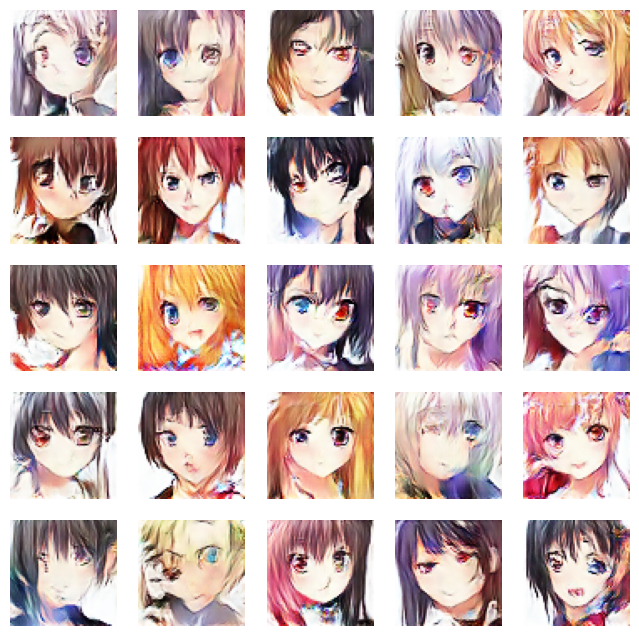

674/674 ━━━━━━━━━━━━━━━━━━━━ 2316s 3s/step - d_loss: 0.6966 - g_loss: 0.7890
Epoch 20/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 50s/step - d_loss: 0.6987 - g_loss: 0.7939 

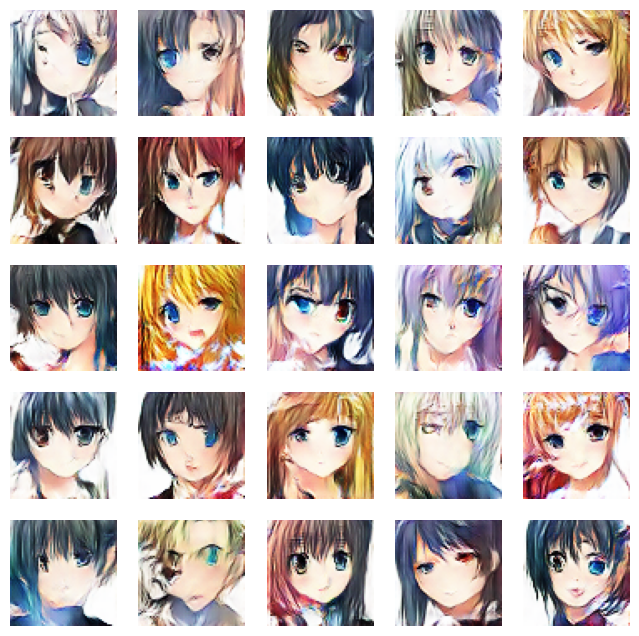

674/674 ━━━━━━━━━━━━━━━━━━━━ 33792s 50s/step - d_loss: 0.6987 - g_loss: 0.7939
Epoch 21/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 780ms/step - d_loss: 0.6982 - g_loss: 0.7834

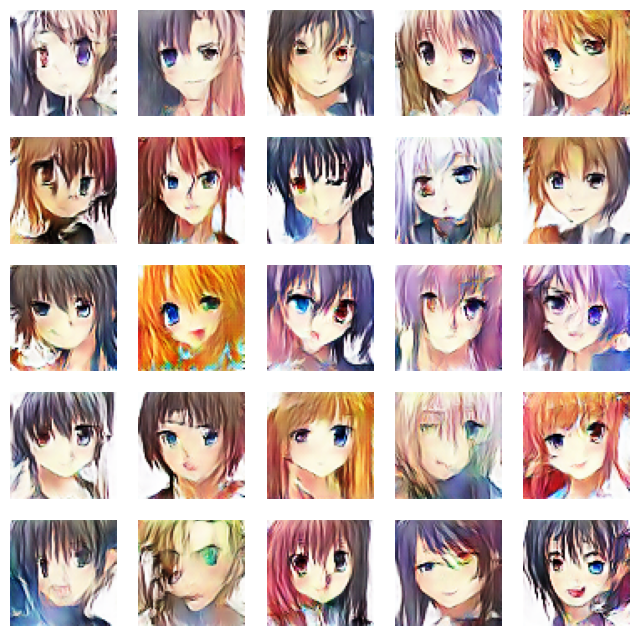

674/674 ━━━━━━━━━━━━━━━━━━━━ 528s 783ms/step - d_loss: 0.6982 - g_loss: 0.7834
Epoch 22/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 789ms/step - d_loss: 0.6926 - g_loss: 0.7975

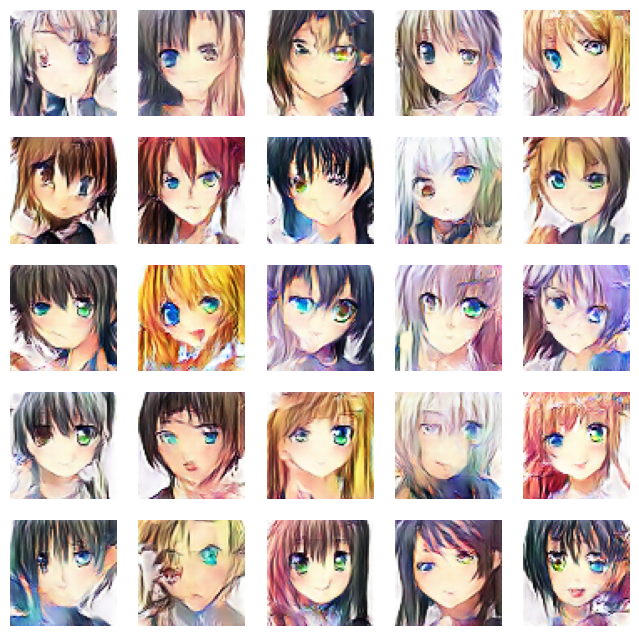

674/674 ━━━━━━━━━━━━━━━━━━━━ 533s 791ms/step - d_loss: 0.6926 - g_loss: 0.7975
Epoch 23/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 740ms/step - d_loss: 0.6914 - g_loss: 0.7916

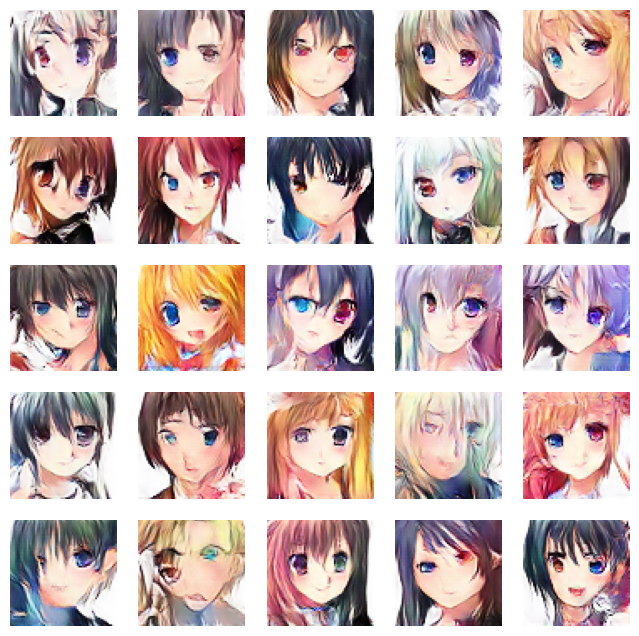

674/674 ━━━━━━━━━━━━━━━━━━━━ 500s 742ms/step - d_loss: 0.6914 - g_loss: 0.7916
Epoch 24/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6887 - g_loss: 0.7895

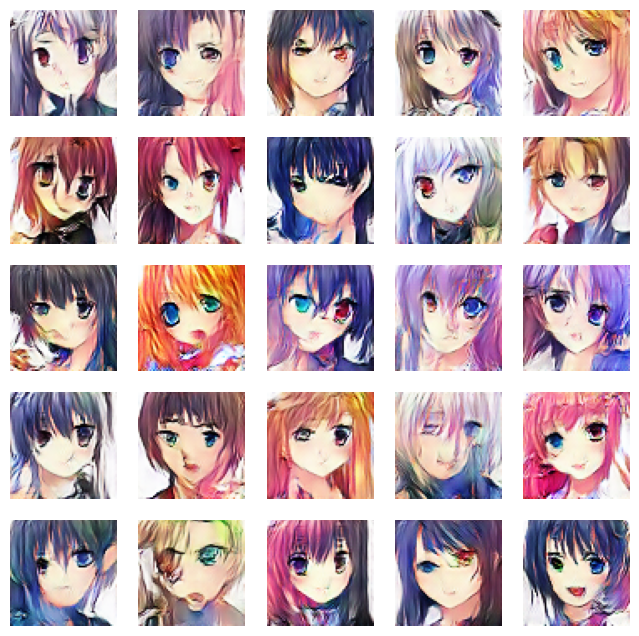

674/674 ━━━━━━━━━━━━━━━━━━━━ 735s 1s/step - d_loss: 0.6887 - g_loss: 0.7895
Epoch 25/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6890 - g_loss: 0.8008

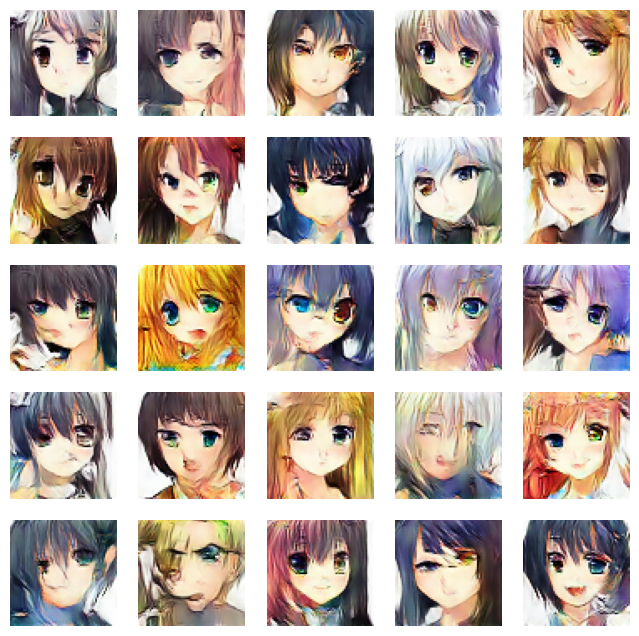

674/674 ━━━━━━━━━━━━━━━━━━━━ 737s 1s/step - d_loss: 0.6890 - g_loss: 0.8008
Epoch 26/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - d_loss: 0.6851 - g_loss: 0.7953

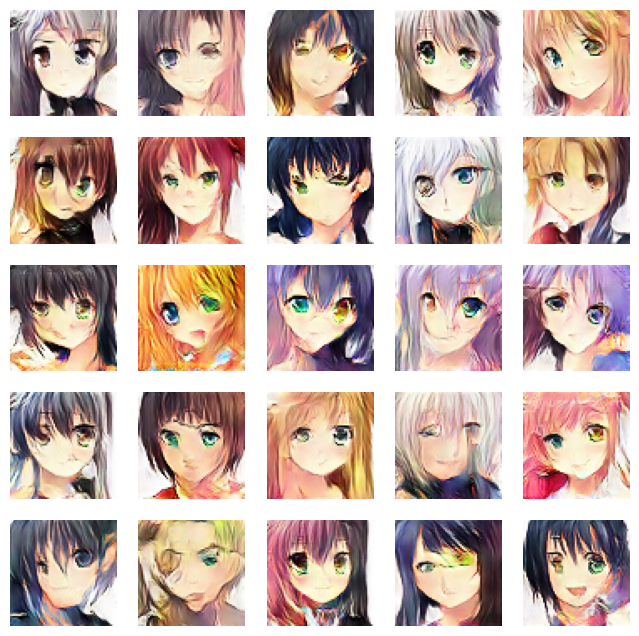

674/674 ━━━━━━━━━━━━━━━━━━━━ 1803s 3s/step - d_loss: 0.6851 - g_loss: 0.7953
Epoch 27/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 746ms/step - d_loss: 0.6829 - g_loss: 0.8015

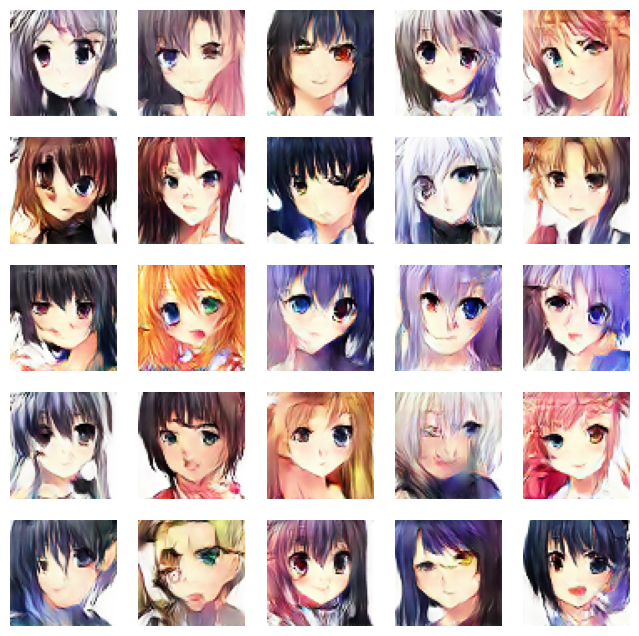

674/674 ━━━━━━━━━━━━━━━━━━━━ 504s 748ms/step - d_loss: 0.6829 - g_loss: 0.8015
Epoch 28/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 10s/step - d_loss: 0.6800 - g_loss: 0.8058

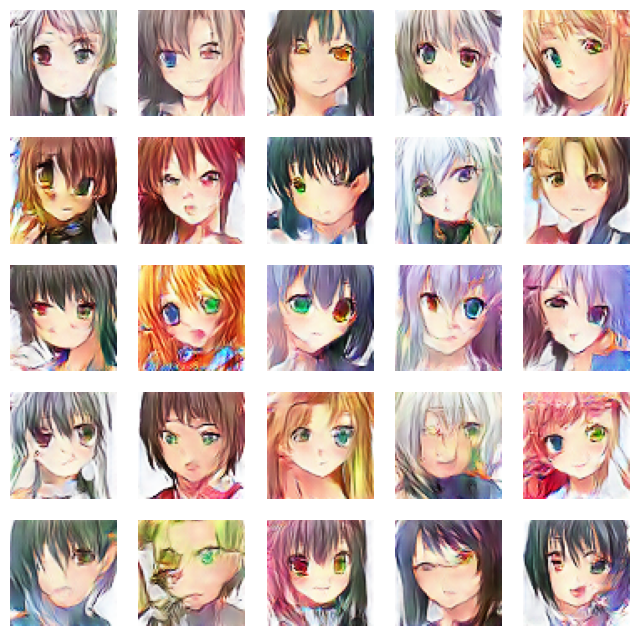

674/674 ━━━━━━━━━━━━━━━━━━━━ 6436s 10s/step - d_loss: 0.6800 - g_loss: 0.8059
Epoch 29/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 144s/step - d_loss: 0.6775 - g_loss: 0.8225  

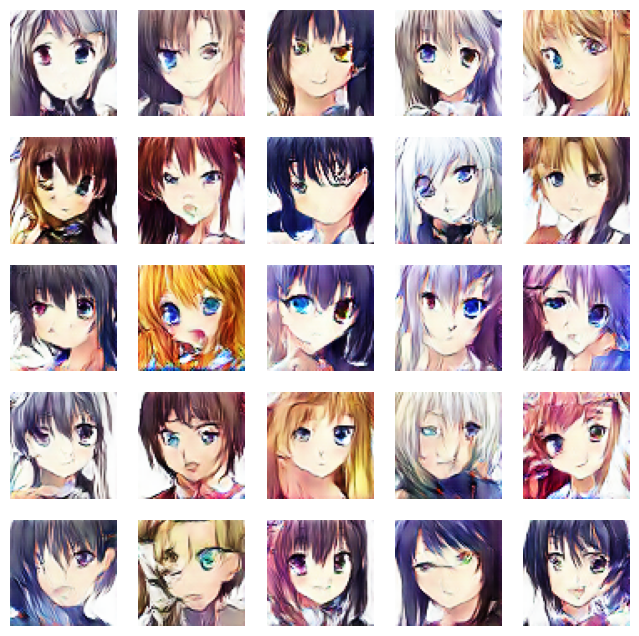

674/674 ━━━━━━━━━━━━━━━━━━━━ 97235s 144s/step - d_loss: 0.6775 - g_loss: 0.8225
Epoch 30/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 13s/step - d_loss: 0.6710 - g_loss: 0.8213 

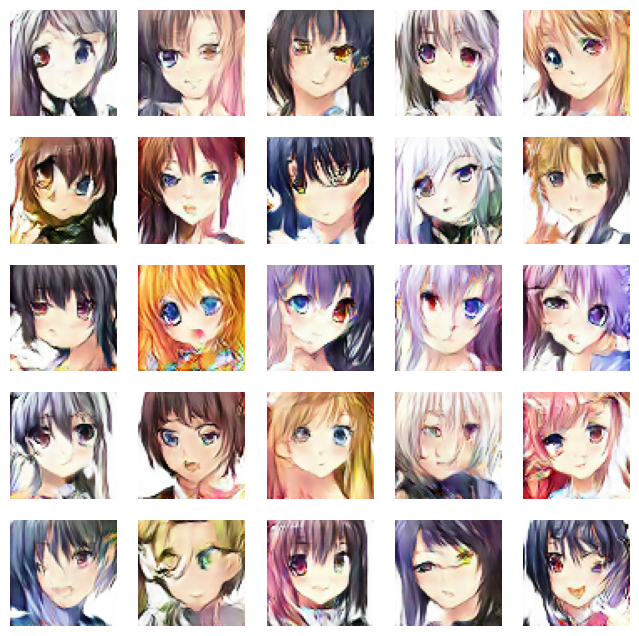

674/674 ━━━━━━━━━━━━━━━━━━━━ 8472s 13s/step - d_loss: 0.6710 - g_loss: 0.8213
Epoch 31/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6688 - g_loss: 0.8242

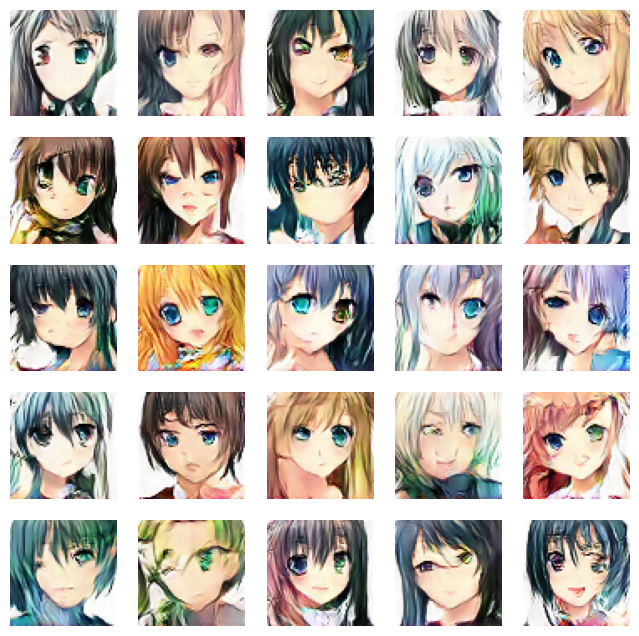

674/674 ━━━━━━━━━━━━━━━━━━━━ 1192s 2s/step - d_loss: 0.6688 - g_loss: 0.8242
Epoch 32/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: 0.6635 - g_loss: 0.8453

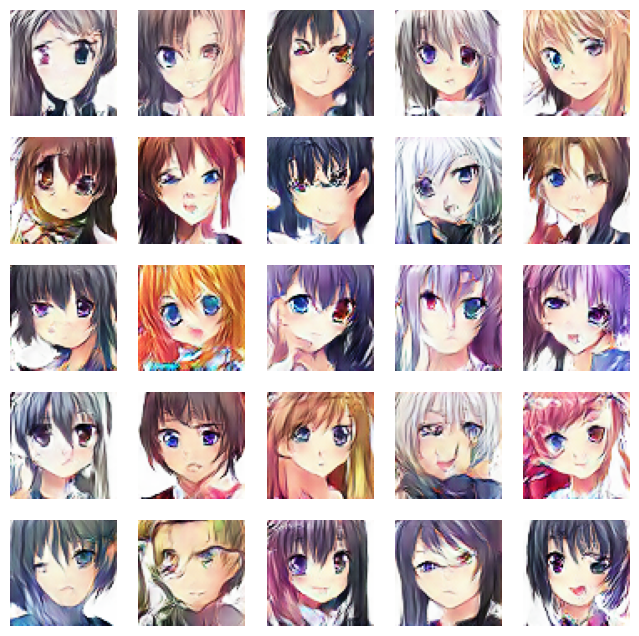

674/674 ━━━━━━━━━━━━━━━━━━━━ 1194s 2s/step - d_loss: 0.6635 - g_loss: 0.8453
Epoch 33/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 25s/step - d_loss: 0.6606 - g_loss: 0.8508 

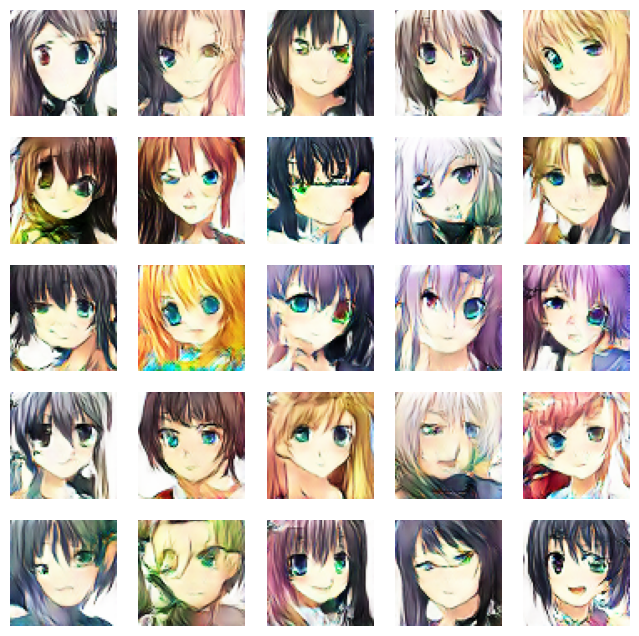

674/674 ━━━━━━━━━━━━━━━━━━━━ 16519s 25s/step - d_loss: 0.6606 - g_loss: 0.8508
Epoch 34/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 827ms/step - d_loss: 0.6612 - g_loss: 0.8669

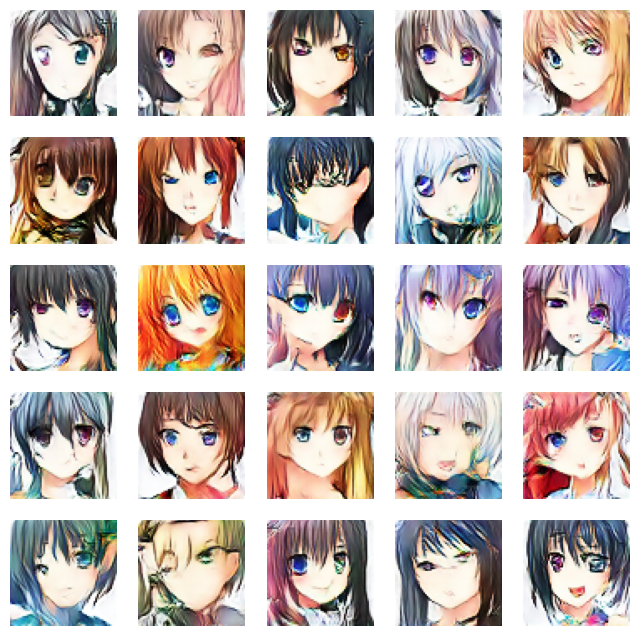

674/674 ━━━━━━━━━━━━━━━━━━━━ 22505s 829ms/step - d_loss: 0.6612 - g_loss: 0.8669
Epoch 35/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 765ms/step - d_loss: 0.6501 - g_loss: 0.8779

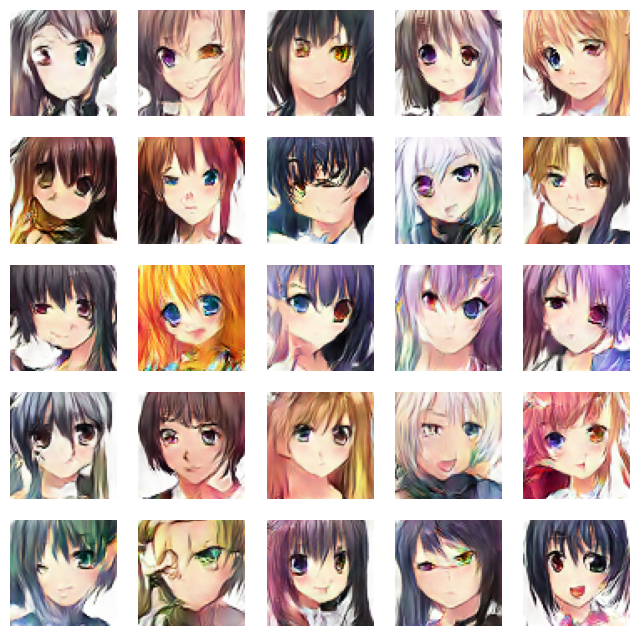

674/674 ━━━━━━━━━━━━━━━━━━━━ 519s 768ms/step - d_loss: 0.6501 - g_loss: 0.8779
Epoch 36/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 732ms/step - d_loss: 0.6473 - g_loss: 0.8871

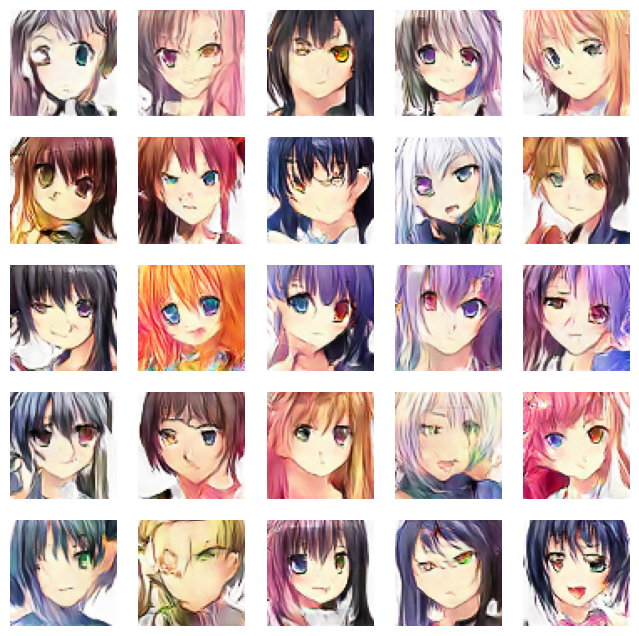

674/674 ━━━━━━━━━━━━━━━━━━━━ 494s 733ms/step - d_loss: 0.6473 - g_loss: 0.8871
Epoch 37/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 738ms/step - d_loss: 0.6433 - g_loss: 0.9074

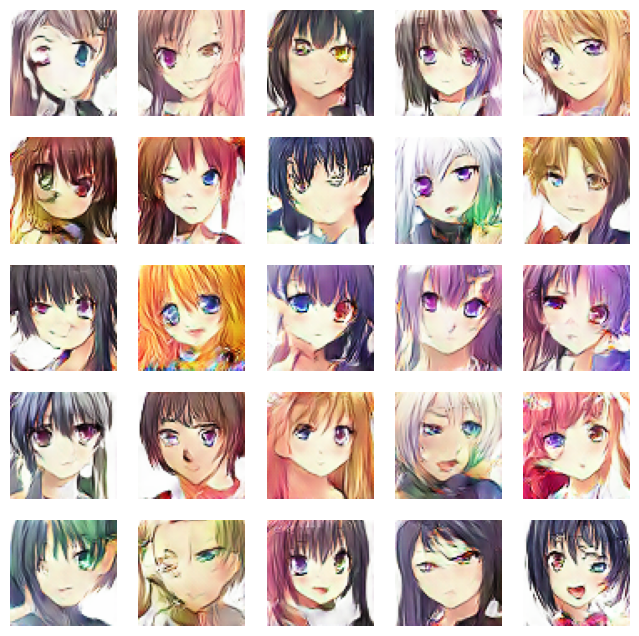

674/674 ━━━━━━━━━━━━━━━━━━━━ 498s 739ms/step - d_loss: 0.6433 - g_loss: 0.9074
Epoch 38/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 12s/step - d_loss: 0.6385 - g_loss: 0.9204 

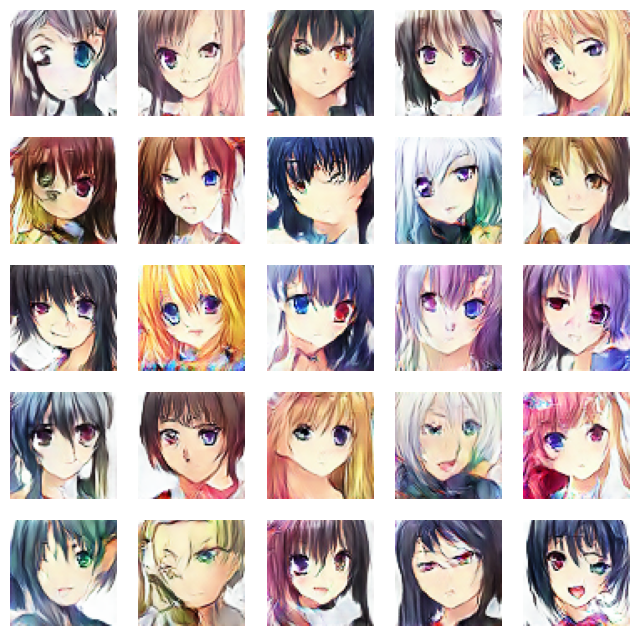

674/674 ━━━━━━━━━━━━━━━━━━━━ 8094s 12s/step - d_loss: 0.6385 - g_loss: 0.9204
Epoch 39/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6351 - g_loss: 0.9289

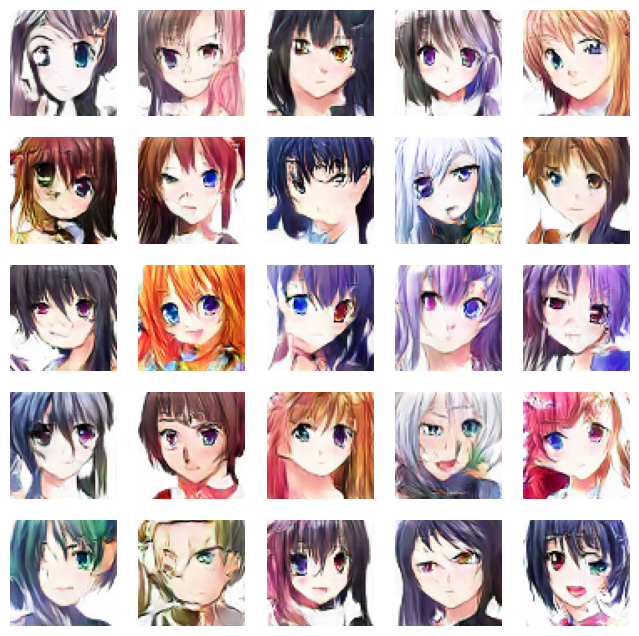

674/674 ━━━━━━━━━━━━━━━━━━━━ 3610s 5s/step - d_loss: 0.6351 - g_loss: 0.9289
Epoch 40/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 443s/step - d_loss: 0.6284 - g_loss: 0.9539  

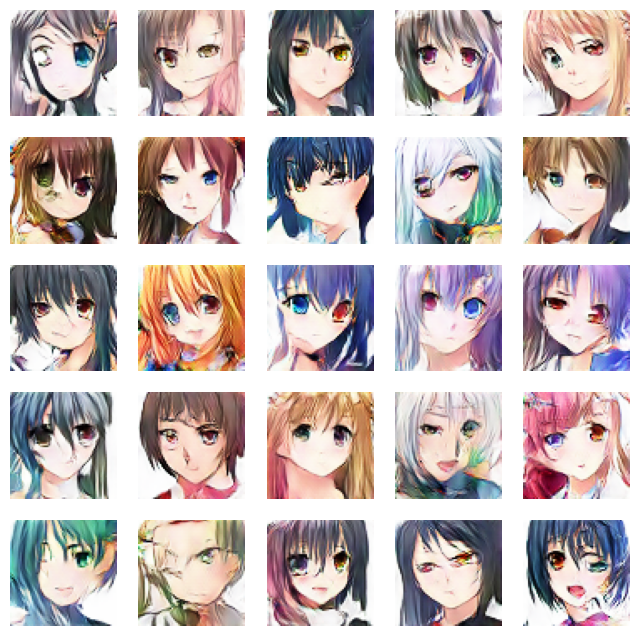

674/674 ━━━━━━━━━━━━━━━━━━━━ 297815s 443s/step - d_loss: 0.6284 - g_loss: 0.9539
Epoch 41/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 308s/step - d_loss: 0.6240 - g_loss: 0.9625  

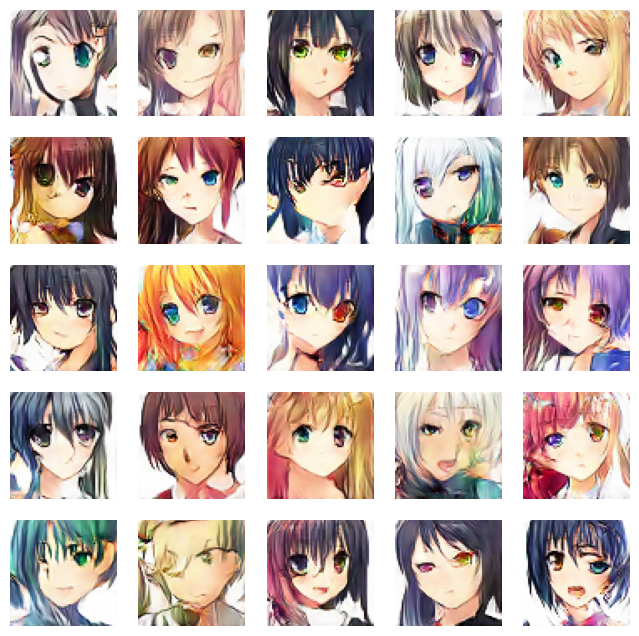

674/674 ━━━━━━━━━━━━━━━━━━━━ 207475s 308s/step - d_loss: 0.6240 - g_loss: 0.9625
Epoch 42/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6168 - g_loss: 0.9768

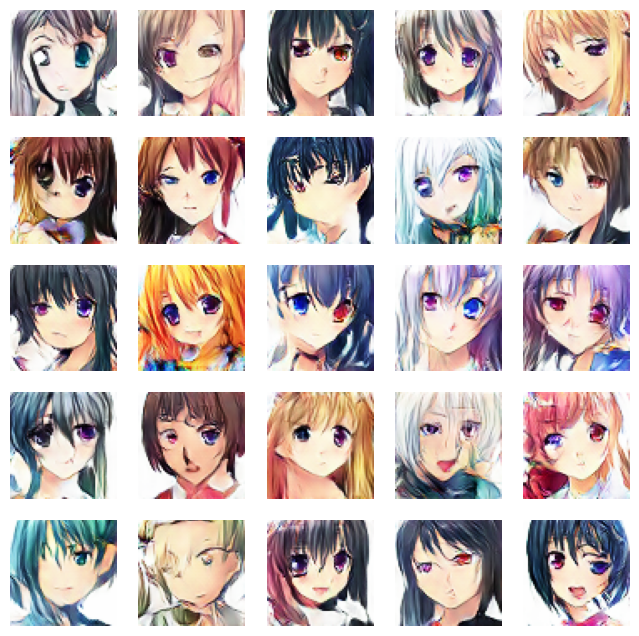

674/674 ━━━━━━━━━━━━━━━━━━━━ 908s 1s/step - d_loss: 0.6168 - g_loss: 0.9768
Epoch 43/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 0.6134 - g_loss: 0.9855

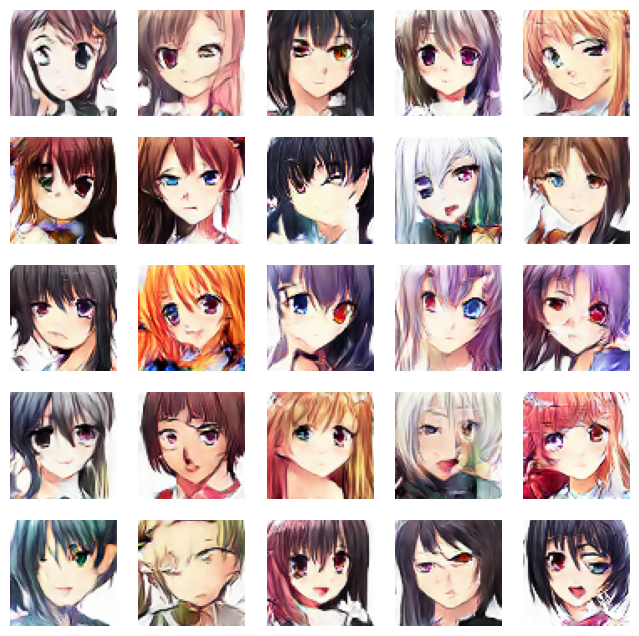

674/674 ━━━━━━━━━━━━━━━━━━━━ 751s 1s/step - d_loss: 0.6134 - g_loss: 0.9855
Epoch 44/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 813ms/step - d_loss: 0.6106 - g_loss: 0.9999

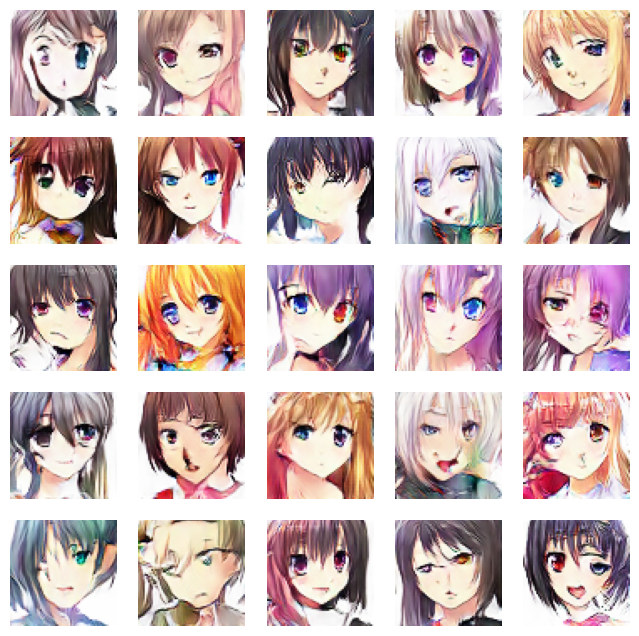

674/674 ━━━━━━━━━━━━━━━━━━━━ 549s 814ms/step - d_loss: 0.6106 - g_loss: 0.9999
Epoch 45/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 801ms/step - d_loss: 0.6100 - g_loss: 1.0114

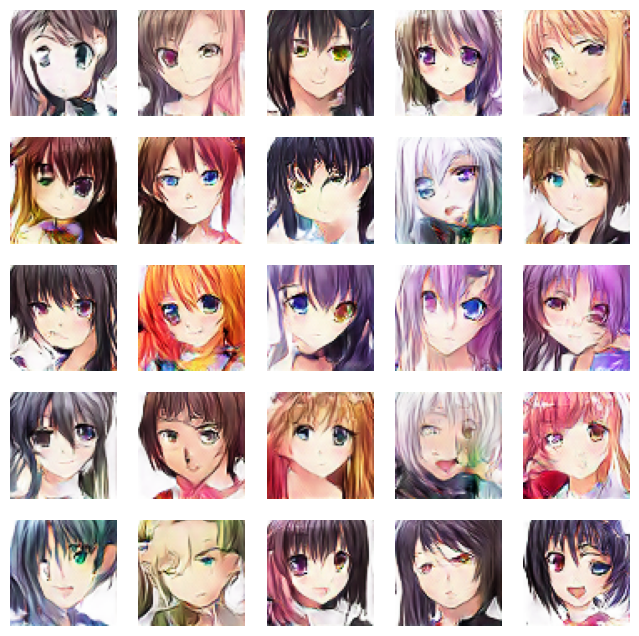

674/674 ━━━━━━━━━━━━━━━━━━━━ 541s 803ms/step - d_loss: 0.6100 - g_loss: 1.0115
Epoch 46/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 854ms/step - d_loss: 0.6014 - g_loss: 1.0300

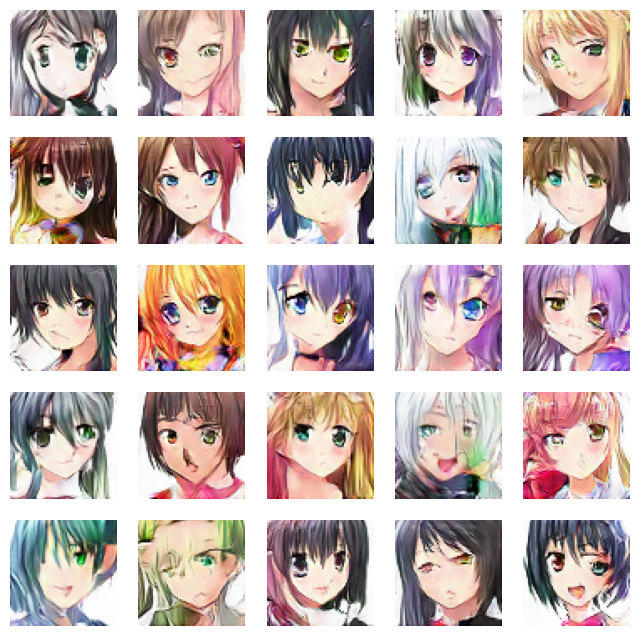

674/674 ━━━━━━━━━━━━━━━━━━━━ 578s 857ms/step - d_loss: 0.6014 - g_loss: 1.0300
Epoch 47/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 733ms/step - d_loss: 0.5990 - g_loss: 1.0605

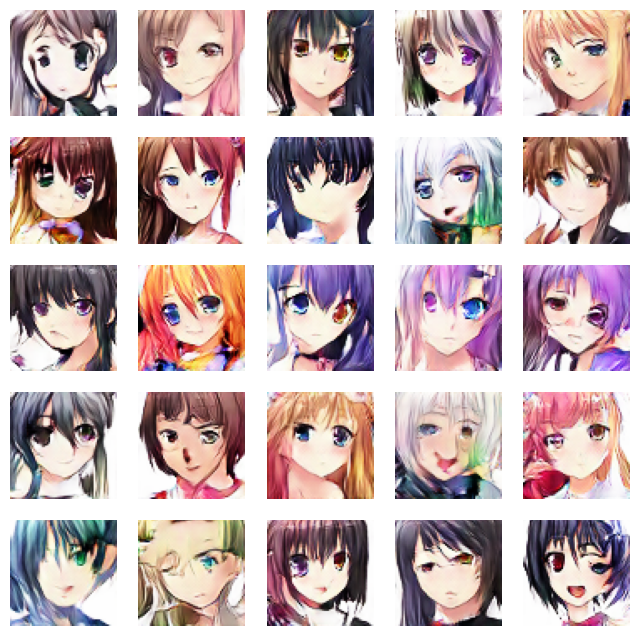

674/674 ━━━━━━━━━━━━━━━━━━━━ 497s 737ms/step - d_loss: 0.5990 - g_loss: 1.0605
Epoch 48/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 700ms/step - d_loss: 0.5871 - g_loss: 1.0646

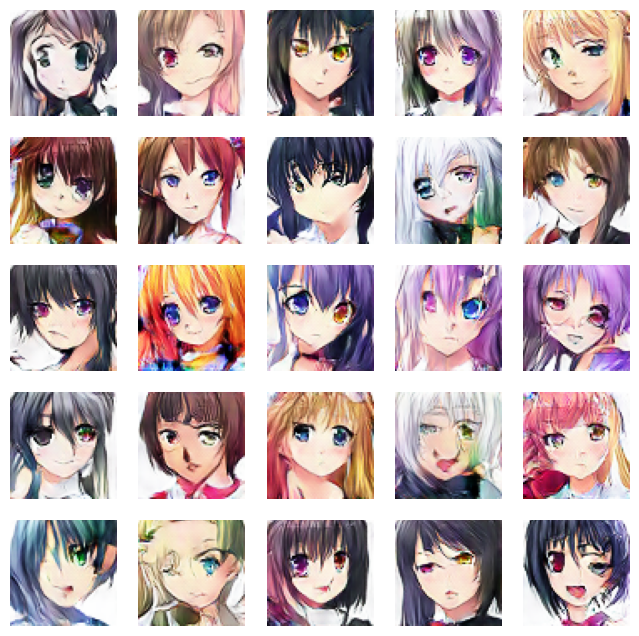

674/674 ━━━━━━━━━━━━━━━━━━━━ 473s 702ms/step - d_loss: 0.5871 - g_loss: 1.0646
Epoch 49/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 770ms/step - d_loss: 0.5889 - g_loss: 1.0756

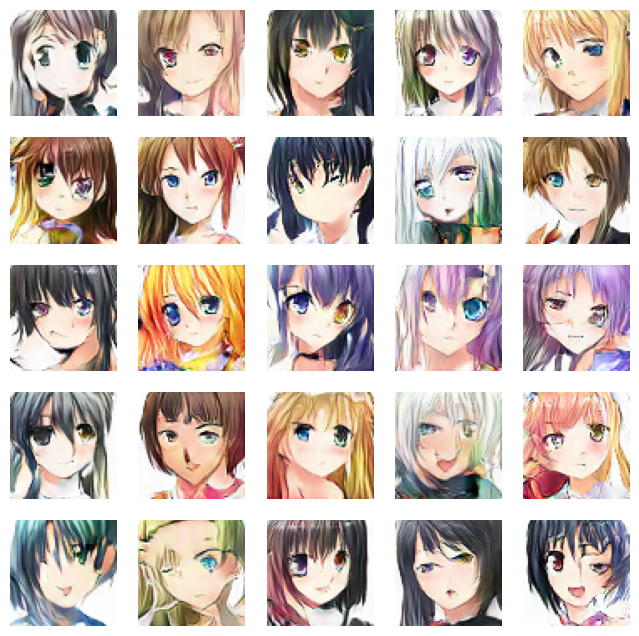

674/674 ━━━━━━━━━━━━━━━━━━━━ 520s 772ms/step - d_loss: 0.5889 - g_loss: 1.0756
Epoch 50/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 766ms/step - d_loss: 0.5858 - g_loss: 1.0985

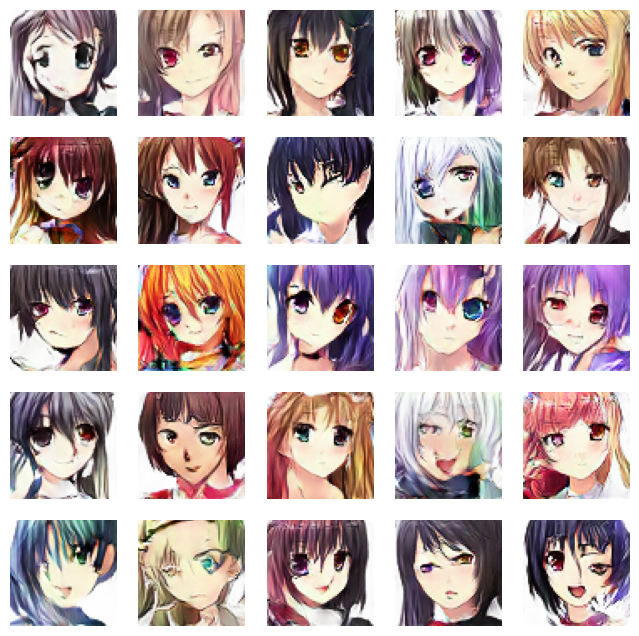

674/674 ━━━━━━━━━━━━━━━━━━━━ 518s 768ms/step - d_loss: 0.5858 - g_loss: 1.0984


In [36]:
dcgan = DCGAN(generator , descriminator , latent_dim)
d_lr = 0.0001
g_lr = 0.0003
dcgan.compile(g_optimizer = Adam(learning_rate=g_lr , beta_1 = 0.5) , d_optimizer = Adam(learning_rate=d_lr , beta_1 = 0.5) , loss_func = BinaryCrossentropy())

num_epochs = 50
dcgan.fit(train_images , epochs = num_epochs , callbacks = [DCGAN_monitor()])

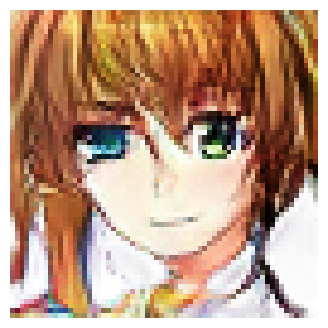

In [94]:
anime_model = tf.keras.models.load_model('generator.h5')

latent_dim = 100
random_noise = tf.random.normal(shape = (1, latent_dim))
fake_image = anime_model(random_noise)
fake_image = (fake_image*127.5) + 127.5
fake_image.numpy()

fig = plt.figure (figsize=(4,4))
image = array_to_img(fake_image[0])
plt.imshow(image)
plt.axis("off")
plt.show()      
